# PRELIMINARIES 

### STEP 1: run each of these in a separate terminal
#### TERMINAL 1:
export SERVER='carta-cav'

ssh -L 8081:localhost:8081 "$SERVER"

#### TERMINAL 2:
export SERVER='carta-cav'

ssh -L 26025:localhost:26025 "$SERVER"

### STEP 2: update the following two lines at the top of
#### multimodal_class.py

to be the appropriate paths on your system

path_to_VRPsolver = '/Users/dan/Documents/transit_webapp/'

path_to_multimodalsim = '/Users/dan/Documents/multimodal/'


### IMPORTS

In [2]:
%load_ext autoreload
%autoreload 2
from multimodal_class import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### CONSTRUCTING FILE NAMES

In [9]:
max_num_people = 200; 
ondemand_cost = 0;
num_iters = 14;
num_drivers_per_group = {'group0':int(7),'group1':int(7),'group2':int(7)}; drivers_per_group = '12n8';
region_assignment = {
    'group0':{'pickup':'south','dropoff':'downtown'},
    'group1':{'pickup':'south','dropoff':'south'},
    'group2':{'pickup':'downtown','dropoff':'downtown'},             
}

name = 'case3'

save_fits_file = 'INPUTS/' + name + '.pickle';
load_fits_file = save_fits_file;
save_outputs_folder = 'OUTPUTS/' + name
dashboard_folder = 'DASH/' + name;
csv_file_path = 'INPUTS/pop_data.csv'
geojson_file = 'INPUTS/regions.geojson'; # + str(regions_num) + '.geojson';

print('geojson_file: ',geojson_file)
print('load_fits_file: ',load_fits_file)
print('save_fits_file: ',save_fits_file)
print('save_outputs_folder: ',save_outputs_folder)
print('dashboard_folder: ',dashboard_folder)

geojson_file:  INPUTS/regions.geojson
load_fits_file:  INPUTS/case3.pickle
save_fits_file:  INPUTS/case3.pickle
save_outputs_folder:  OUTPUTS/case3
dashboard_folder:  DASH/case3


### INITIAL PARAMETER INPUTS

In [10]:
params = {'csv_file_path': csv_file_path, #'INPUTS/PRE_micro_0.csv', 
          'modes':['drive','walk','gtfs','ondemand'],
          'time_window': [21600,36000], # in seconds. 6 AM to 10 AM
          'bnds':[np.array([-85.3394,  34.9458]), # bottom left
                  np.array([-85.2494,  35.0658])], # top right
          'groups_regions_geojson': geojson_file, #'INPUTS/regions3.geojson', 
          'max_num_people':max_num_people, 
          # 'groups_regions_pickup_geojson': geojson_pickup_file, #'INPUTS/regions3.geojson', 
          # 'groups_regions_dropoff_geojson': geojson_dropoff_file, #'INPUTS/regions3.geojson', 
          'num_drivers_per_group': num_drivers_per_group, #{'group0':int(10),'group1':int(4),'group2':int(4)},
          'region_assignment': region_assignment,
          'monetary_costs':{'ondemand':0,'gtfs':1.5},
          # 'background_congestion_file': 'INPUTS/background_traffic1.obj',  # OPTIONAL - LOADS BACKGROUND TRAFFIC
          ############ PRECOMPUTED GTFS DATA ###########
          'load_ondemand_fits': load_fits_file, #'INPUTS/load_file.pickle', 
          'save_ondemand_fits': save_fits_file, #'INPUTS/save_file.pickle',
          'gtfs_feed_file': 'INPUTS/carta_gtfs.zip', 
          'gtfs_precomputed_file': 'INPUTS/gtfs_trips.obj'}

In [11]:
if not os.path.exists(save_outputs_folder):
    os.mkdir(save_outputs_folder);
    os.mkdir(save_outputs_folder+'/figs');

In [12]:
if False: #not os.path.exists(csv_file_path):
    df = GENERATE_SAMPLE_POPULATION('data/pop/lodes_combinations_upd.parquet',filter_region_path=geojson_file,sample_num = 10000)
    df.to_csv(csv_file_path); #, index_label='tag')'INPUTS/new_pop_data1.csv'

In [13]:
# OPTION-1: FULL ONE-SHOT SETUP 
# BLAH = WORLD(params,full_setup = True)
# OPTION-2: STEP-BY-STEP SETUP
WORLD1 = WORLD(params)
WORLD1.initGRAPHSnFEEDS();
WORLD1.initREGIONS();

monetary cost of drive segment: 0 $
monetary cost of walk segment: 0 $
monetary cost of gtfs segment: 1.5 $
monetary cost of ondemand segment: 0 $
loading graph/feed for drive mode...
loading graph/feed for walk mode...
loading graph/feed for gtfs mode...
connecting close bus stops...
Original num of edges:  2113
Final num of edges:  3849
loading graph/feed for ondemand mode...
cutting graphs to boundaries...
composing graphs...
computing reverse graphs...
...reversing drive graph...
...reversing walk graph...
...reversing gtfs graph...
...reversing ondemand graph...
...reversing all graph...


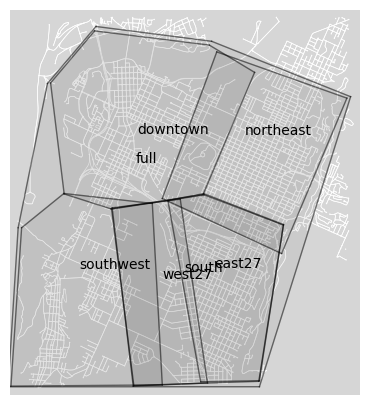

In [32]:
WORLD1.plotREGIONS(figsize=(5,5),includes={'labels':True},
                   specregions=['full','downtown','south','northeast','southwest','west27','east27']);
                   # specregions=['downtown','south','northeast','southwest']); #'west27','east27']);

In [15]:
WORLD1.initNETWORKS();
WORLD1.initCONVERTER();
WORLD1.initSTATS()
WORLD1.initONDEMAND();
WORLD1.initPEOPLE();
WORLD1.initBACKGROUND();

constructing NETWORK  drive mode...
constructing NETWORK  walk mode...
constructing NETWORK  gtfs mode...
constructing NETWORK  ondemand mode...
adding 7 to group0 ...
adding 7 to group1 ...
adding 7 to group2 ...
LOADING POPULATION DATA:
Using the default year of 2021
Using FIPS code '47' for input 'TN'
Using FIPS code '065' for input 'Hamilton'
filtering population data...
len of df before: 10000
len of df after: 10000
time to setup origins & dests:  0.5717902183532715
Done setting up on-demand service
ADDING NODES BY TYPE...
starting gtfs...
0
100
200
300
400
500
600
700
800
starting transit nodes...
0
100
200
300
400
500
time to create nodes...:  46.954245805740356
starting delivery1 sources...
0
starting delivery2 sources...
0
starting source nodes...
0
200
starting target nodes...
0
200
time to create nodes...:  14.22487998008728
GENERATING POPULATION OF 200 ...
adding person 0 ...
adding person 10 ...
adding person 20 ...
adding person 30 ...
adding person 40 ...
adding person 5

### PLOT ODS & REGIONS

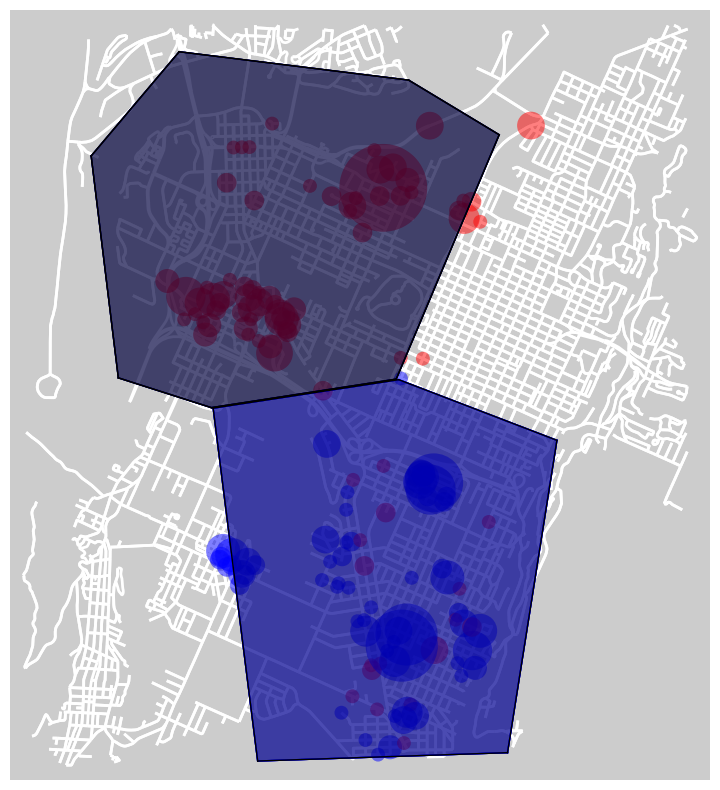

In [16]:
from multimodal_class import *
WORLD1.plotPRELIMINARIES(include_demand_curves=False,save_file=save_outputs_folder+'/figs/od_regions.png',figsize=(10,10));

### FIT CONGESTION DEMAND MODELS

In [17]:
from multimodal_class import *
WORLD1.load_fits = False;
# counts = {'num_counts':8,'num_per_count':1}
counts = {'num_counts':4,'num_per_count':1}
WORLD1.fitModels(counts=counts,force_initialize=True);

load fits not specified...
generating fits...
updating individual choices...
person2662 ...
person7086 ...
DEMAND CURVE - generate (takes 10 MIN...)
...runs VRP solver (num_pts*num_per_count) times...
### ~ approx. 1 run/15 seconds...
starting on-demand curve computations for a total of 280 trips...
starting on-demand curve computation for group NUMBER  0
...for a total number of trips of 136
counts to compute:  [13, 49, 85, 121]
...computing averages for 13 active ondemand trips in group0 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:17:21,988: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:17:22,272: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:17:22,553: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:17:22,554: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:17:22,555: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:17:22,556: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:17:22,560: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:17:22,562: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:17:22,567: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2121.6428571428573
...computing averages for 49 active ondemand trips in group0 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:18:17,274: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:18:18,136: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:18:19,036: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:18:19,037: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:18:19,038: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:18:19,038: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:18:19,039: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:18:19,039: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:18:19,041: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2365.28
...computing averages for 85 active ondemand trips in group0 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:20:38,711: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:20:40,450: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:20:42,276: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:20:42,277: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:20:42,277: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:20:42,277: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:20:42,278: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:20:42,278: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:20:42,280: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2481.602409638554
...computing averages for 121 active ondemand trips in group0 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:24:30,827: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:24:33,624: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:24:36,717: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:24:36,718: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:24:36,718: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:24:36,719: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:24:36,719: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:24:36,720: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:24:36,721: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2456.978947368421
starting on-demand curve computation for group NUMBER  1
...for a total number of trips of 87
counts to compute:  [8, 31, 54, 77]
...computing averages for 8 active ondemand trips in group1 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:28:35,696: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:28:35,922: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:28:36,151: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:28:36,153: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:28:36,153: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:28:36,154: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:28:36,155: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:28:36,156: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:28:36,158: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  1544.2222222222222
...computing averages for 31 active ondemand trips in group1 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:28:59,926: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:29:00,497: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:29:01,085: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:29:01,087: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:29:01,087: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:29:01,088: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:29:01,089: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:29:01,090: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:29:01,092: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  1702.25
...computing averages for 54 active ondemand trips in group1 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:29:47,576: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:29:48,616: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:29:49,688: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:29:49,690: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:29:49,691: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:29:49,691: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:29:49,692: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:29:49,692: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:29:49,694: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2306.0363636363636
...computing averages for 77 active ondemand trips in group1 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:30:59,295: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:31:00,969: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:31:02,713: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:31:02,715: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:31:02,715: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:31:02,716: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:31:02,717: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:31:02,718: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:31:02,719: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  2051.730769230769
starting on-demand curve computation for group NUMBER  2
...for a total number of trips of 57
counts to compute:  [5, 20, 35, 50]
...computing averages for 5 active ondemand trips in group2 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:32:38,386: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:32:38,574: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:32:38,761: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:32:38,762: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:32:38,763: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:32:38,764: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:32:38,765: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:32:38,765: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:32:38,767: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  868.0
...computing averages for 20 active ondemand trips in group2 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:32:56,575: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:32:56,918: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:32:57,312: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:32:57,314: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:32:57,314: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:32:57,315: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:32:57,315: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:32:57,316: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:32:57,317: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  1555.952380952381
...computing averages for 35 active ondemand trips in group2 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:33:29,624: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:33:30,247: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:33:30,877: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:33:30,879: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:33:30,880: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:33:30,880: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:33:30,881: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:33:30,882: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:33:30,883: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  1847.138888888889
...computing averages for 50 active ondemand trips in group2 ...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:34:08,403: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:34:09,331: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:34:10,297: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:34:10,298: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:34:10,299: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:34:10,300: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:34:10,300: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:34:10,301: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:34:10,302: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...average manifest trip time:  1952.0392156862745


### PRELIMINARY DEMAND CURVES (OPTIONAL)

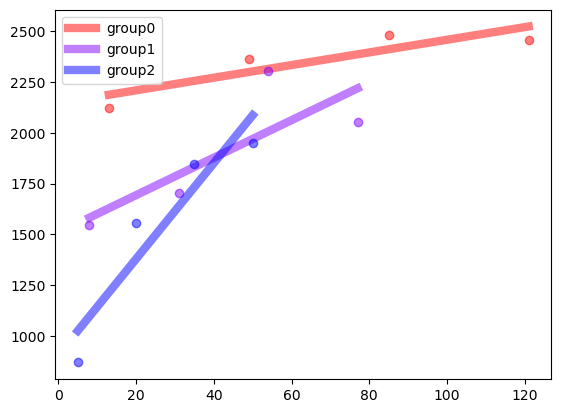

In [18]:
colors = {'group0':[1,0,0,0.5],'group1':[0.5,0,1,0.5],'group2':[0,0,1,0.5],'group3':[1,0.5,0.,0.5]};
WORLD1.ONDEMAND.plotCongestionModels(colors=colors,save_file=save_outputs_folder+'/figs/demand_curves.pdf')

### SAVE CONGESTION DEMAND MODELS (OPTIONAL)

In [19]:
# WORLD1.save_fits = True; #se; # must be set to True
# WORLD1.save_fits_file = save_fits_file; 
# WORLD1.saveFits();

# RUN SIMULATION

In [20]:
from multimodal_class import *
# num_iters = 6;
WORLD1.SIM(num_iters = num_iters, restart = False, constants = ['drive','gtfs','walk']);
# WORLD1.initUNCONGESTED()

------------------ITERATION 1 -----------
starting gtfs computations...
...with  255  active trips...
REMOVING MASS FROM GTFS TRIPS...
starting driving computations...
...with  0  active trips...
starting walking computations...
...with  174  active trips...
...segment 0 ...
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 136 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:36:34,257: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:36:37,648: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:36:41,297: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:36:41,297: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:36:41,298: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:36:41,298: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:36:41,298: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:36:41,299: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:36:41,300: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: -688.8337254357286
...actual num trips: 136
...adjusting cost estimate by 412.4168627178643
...average manifest trip time:  2616.821052631579
...changing cost est from 0.0 to 2147.4978435898984
COMPUTING ondemand trips for  group1
...with 87 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:41:09,559: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:41:11,456: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:41:13,415: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:41:13,416: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:41:13,417: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:41:13,417: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:41:13,418: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:41:13,418: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:41:13,419: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: -163.1348089833326
...actual num trips: 87
...adjusting cost estimate by 125.0674044916663
...average manifest trip time:  2152.681818181818
...changing cost est from 0.0 to 1508.1543596500123
COMPUTING ondemand trips for  group2
...with 57 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:43:05,098: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:43:06,109: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:43:07,132: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:43:07,133: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:43:07,134: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:43:07,134: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:43:07,135: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:43:07,135: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:43:07,137: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: -38.361518796878585
...actual num trips: 57
...adjusting cost estimate by 47.68075939843929
...average manifest trip time:  2063.603448275862
...changing cost est from 0.0 to 906.1768596327423
updating individual choices...
person2662 ...
iteration time:  540.1107821464539
------------------ITERATION 2 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 122 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:44:09,954: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:44:12,704: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:44:15,673: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:44:15,674: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:44:15,674: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:44:15,675: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:44:15,675: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:44:15,675: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:44:15,676: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 0.0
...actual num trips: 122
...adjusting cost estimate by 40.666666666666664
...average manifest trip time:  2732.3473684210526
...changing cost est from 2147.4978435898984 to 2188.164510256565
COMPUTING ondemand trips for  group1
...with 21 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:49:00,944: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:49:01,393: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:49:01,867: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:49:01,868: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:49:01,868: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:49:01,869: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:49:01,869: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:49:01,870: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:49:01,875: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 0.0
...actual num trips: 21
...adjusting cost estimate by 7.0


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:49:41,355: called


...average manifest trip time:  2514.7272727272725
...changing cost est from 1508.1543596500123 to 1515.1543596500123
COMPUTING ondemand trips for  group2
...with 3 active ondemand trips...


[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:49:41,525: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:49:41,695: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:49:41,696: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:49:41,697: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:49:41,698: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:49:41,699: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:49:41,700: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:49:41,701: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBUG2024-06-26 07:49:42,707: VRP: Adding Distance Dimension (routing.AddDimension) 

...expected num of trips given cost: 0.0
...actual num trips: 3
...adjusting cost estimate by 1.0
...average manifest trip time:  817.25
...changing cost est from 906.1768596327423 to 907.1768596327423
updating individual choices...
person2662 ...
iteration time:  352.078417301178
------------------ITERATION 3 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 113 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:50:01,543: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:50:04,039: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:50:06,768: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:50:06,768: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:50:06,769: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:50:06,769: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:50:06,769: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:50:06,770: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:50:06,771: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 13.044283878872356
...actual num trips: 113
...adjusting cost estimate by 24.98892903028191
...average manifest trip time:  2539.288888888889
...changing cost est from 2188.164510256565 to 2213.1534392868466
COMPUTING ondemand trips for  group1
...with 14 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:54:51,336: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:54:51,710: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:54:52,029: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:54:52,031: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:54:52,032: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:54:52,033: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:54:52,034: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:54:52,034: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:54:52,036: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 0.757179565590575
...actual num trips: 14
...adjusting cost estimate by 3.3107051086023565


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:55:18,577: called


...average manifest trip time:  1633.8
...changing cost est from 1515.1543596500123 to 1518.4650647586147
COMPUTING ondemand trips for  group2
...with 3 active ondemand trips...


[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:55:18,745: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:55:18,928: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:55:18,929: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:55:18,930: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:55:18,931: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:55:18,932: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:55:18,933: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:55:18,934: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBUG2024-06-26 07:55:19,939: VRP: Adding Distance Dimension (routing.AddDimension) 

...expected num of trips given cost: 0.042333368358606994
...actual num trips: 3
...adjusting cost estimate by 0.7394166579103483
...average manifest trip time:  461.5
...changing cost est from 907.1768596327423 to 907.9162762906527
updating individual choices...
person2662 ...
iteration time:  337.45016598701477
------------------ITERATION 4 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 103 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 07:55:38,360: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 07:55:40,664: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 07:55:43,045: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 07:55:43,046: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 07:55:43,046: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 07:55:43,047: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 07:55:43,047: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 07:55:43,047: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 07:55:43,048: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 21.059759717396716
...actual num trips: 103
...adjusting cost estimate by 16.388048056520656
...average manifest trip time:  2688.8977272727275
...changing cost est from 2213.1534392868466 to 2229.5414873433674
COMPUTING ondemand trips for  group1
...with 13 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:00:31,025: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:00:31,310: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:00:31,605: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:00:31,607: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:00:31,608: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:00:31,608: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:00:31,610: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:00:31,611: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:00:31,612: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 1.1152936021520132
...actual num trips: 13
...adjusting cost estimate by 2.3769412795695977
...average manifest trip time:  1636.9285714285713
...changing cost est from 1518.4650647586147 to 1520.8420060381843
COMPUTING ondemand trips for  group2
...with 4 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:00:58,201: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:00:58,387: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:00:58,569: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:00:58,570: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:00:58,571: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:00:58,572: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:00:58,573: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:00:58,573: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:00:58,575: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 0.07363536610841791
...actual num trips: 4
...adjusting cost estimate by 0.7852729267783165
...average manifest trip time:  861.4
...changing cost est from 907.9162762906527 to 908.7015492174311
updating individual choices...
person2662 ...
iteration time:  339.74913787841797
------------------ITERATION 5 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 100 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:01:17,955: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:01:20,227: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:01:22,623: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:01:22,624: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:01:22,624: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:01:22,625: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:01:22,625: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:01:22,625: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:01:22,626: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 26.316407694524433
...actual num trips: 100
...adjusting cost estimate by 12.280598717579261
...average manifest trip time:  2908.6046511627906
...changing cost est from 2229.5414873433674 to 2241.8220860609467
COMPUTING ondemand trips for  group1
...with 12 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:06:33,001: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:06:33,265: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:06:33,537: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:06:33,539: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:06:33,539: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:06:33,540: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:06:33,541: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:06:33,541: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:06:33,543: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 1.3724037972232686
...actual num trips: 12
...adjusting cost estimate by 1.7712660337961217
...average manifest trip time:  1277.3846153846155
...changing cost est from 1520.8420060381843 to 1522.6132720719804
COMPUTING ondemand trips for  group2
...with 4 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:06:58,032: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:06:58,732: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:06:58,914: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:06:58,916: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:06:58,917: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:06:58,918: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:06:58,919: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:06:58,920: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:06:58,921: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 0.10687861417976771
...actual num trips: 4
...adjusting cost estimate by 0.648853564303372
...average manifest trip time:  827.2
...changing cost est from 908.7015492174311 to 909.3504027817345
updating individual choices...
person2662 ...
iteration time:  361.94047713279724
------------------ITERATION 6 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 95 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:07:19,614: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:07:21,565: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:07:23,655: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:07:23,656: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:07:23,656: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:07:23,656: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:07:23,657: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:07:23,657: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:07:23,658: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 30.255545789802
...actual num trips: 95
...adjusting cost estimate by 9.249207744313999
...average manifest trip time:  2654.318181818182
...changing cost est from 2241.8220860609467 to 2251.0712938052607
COMPUTING ondemand trips for  group1
...with 13 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:12:10,512: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:12:10,796: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:12:11,092: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:12:11,093: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:12:11,094: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:12:11,095: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:12:11,095: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:12:11,096: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:12:11,097: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 1.5639990037968514
...actual num trips: 13
...adjusting cost estimate by 1.633714428029021
...average manifest trip time:  1407.2857142857142
...changing cost est from 1522.6132720719804 to 1524.2469865000094
COMPUTING ondemand trips for  group2
...with 4 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:12:38,832: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:12:39,008: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:12:39,187: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:12:39,189: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:12:39,190: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:12:39,190: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:12:39,191: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:12:39,192: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:12:39,193: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 0.134346771128219
...actual num trips: 4
...adjusting cost estimate by 0.5522361755531116
...average manifest trip time:  656.4
...changing cost est from 909.3504027817345 to 909.9026389572876
updating individual choices...
person2662 ...
iteration time:  339.313353061676
------------------ITERATION 7 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 90 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:12:58,660: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:13:00,545: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:13:02,610: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:13:02,610: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:13:02,611: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:13:02,611: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:13:02,612: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:13:02,612: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:13:02,613: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 33.222331645658464
...actual num trips: 90
...adjusting cost estimate by 7.097208544292692
...average manifest trip time:  2652.5176470588235
...changing cost est from 2251.0712938052607 to 2258.1685023495534
COMPUTING ondemand trips for  group1
...with 12 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:17:40,968: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:17:41,242: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:17:41,524: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:17:41,526: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:17:41,527: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:17:41,528: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:17:41,529: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:17:41,529: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:17:41,530: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 1.7407154582131394
...actual num trips: 12
...adjusting cost estimate by 1.2824105677233575


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:18:06,133: called


...average manifest trip time:  1277.3846153846155
...changing cost est from 1524.2469865000094 to 1525.5293970677328
COMPUTING ondemand trips for  group2
...with 3 active ondemand trips...


[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:18:06,305: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:18:06,481: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:18:06,483: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:18:06,484: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:18:06,485: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:18:06,485: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:18:06,486: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:18:06,488: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBUG2024-06-26 08:18:07,496: VRP: Adding Distance Dimension (routing.AddDimension) 

...expected num of trips given cost: 0.15772478856885935
...actual num trips: 3
...adjusting cost estimate by 0.35528440142889256
...average manifest trip time:  567.5
...changing cost est from 909.9026389572876 to 910.2579233587165
updating individual choices...
person2662 ...
iteration time:  326.4947679042816
------------------ITERATION 8 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 89 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:18:25,189: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:18:26,961: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:18:28,781: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:18:28,782: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:18:28,782: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:18:28,783: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:18:28,783: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:18:28,784: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:18:28,785: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 35.49883991613336
...actual num trips: 89
...adjusting cost estimate by 5.944573342651848
...average manifest trip time:  2453.764705882353
...changing cost est from 2258.1685023495534 to 2264.1130756922053
COMPUTING ondemand trips for  group1
...with 12 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:22:48,895: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:22:49,159: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:22:49,439: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:22:49,440: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:22:49,441: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:22:49,442: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:22:49,442: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:22:49,443: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:22:49,444: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 1.8794318977242253
...actual num trips: 12
...adjusting cost estimate by 1.1245075669195304


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:23:13,856: called


...average manifest trip time:  1277.3846153846155
...changing cost est from 1525.5293970677328 to 1526.6539046346522
COMPUTING ondemand trips for  group2
...with 2 active ondemand trips...


[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:23:14,016: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:23:14,176: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:23:14,177: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:23:14,177: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:23:14,178: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:23:14,179: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:23:14,180: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:23:14,181: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBUG2024-06-26 08:23:15,192: VRP: Adding Distance Dimension (routing.AddDimension) 

...expected num of trips given cost: 0.17276517400661573
...actual num trips: 2
...adjusting cost estimate by 0.20302609177704267
...average manifest trip time:  204.66666666666666
...changing cost est from 910.2579233587165 to 910.4609494504936
updating individual choices...
person2662 ...
iteration time:  307.1894929409027
------------------ITERATION 9 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 89 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:23:32,371: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:23:34,320: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:23:36,274: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:23:36,275: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:23:36,275: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:23:36,275: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:23:36,276: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:23:36,276: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:23:36,277: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 37.40562767564965
...actual num trips: 89
...adjusting cost estimate by 5.159437232435035
...average manifest trip time:  2453.764705882353
...changing cost est from 2264.1130756922053 to 2269.27251292464
COMPUTING ondemand trips for  group1
...with 12 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:27:53,064: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:27:53,325: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:27:53,599: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:27:53,600: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:27:53,601: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:27:53,601: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:27:53,602: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:27:53,603: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:27:53,604: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 2.0010682050132766
...actual num trips: 12
...adjusting cost estimate by 0.9998931794986725


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:28:18,089: called


...average manifest trip time:  1277.3846153846155
...changing cost est from 1526.6539046346522 to 1527.653797814151
COMPUTING ondemand trips for  group2
...with 2 active ondemand trips...


[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:28:18,247: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:28:18,407: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:28:18,408: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:28:18,409: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:28:18,410: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:28:18,412: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:28:18,412: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:28:18,414: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBUG2024-06-26 08:28:19,423: VRP: Adding Distance Dimension (routing.AddDimension) 

...expected num of trips given cost: 0.18135995233622063
...actual num trips: 2
...adjusting cost estimate by 0.18186400476637796
...average manifest trip time:  204.66666666666666
...changing cost est from 910.4609494504936 to 910.6428134552599
updating individual choices...
person2662 ...
iteration time:  304.2421851158142
------------------ITERATION 10 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 89 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:28:36,582: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:28:38,363: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:28:40,213: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:28:40,214: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:28:40,215: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:28:40,215: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:28:40,216: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:28:40,216: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:28:40,217: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 39.06057432929973
...actual num trips: 89
...adjusting cost estimate by 4.539947788245479
...average manifest trip time:  2453.764705882353
...changing cost est from 2269.27251292464 to 2273.8124607128857
COMPUTING ondemand trips for  group1
...with 12 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:32:58,263: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:32:58,537: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:32:59,077: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:32:59,079: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:32:59,079: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:32:59,080: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:32:59,080: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:32:59,081: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:32:59,082: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 2.1092251597689646
...actual num trips: 12
...adjusting cost estimate by 0.8991613491119124


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:33:23,506: called


...average manifest trip time:  1277.3846153846155
...changing cost est from 1527.653797814151 to 1528.5529591632628
COMPUTING ondemand trips for  group2
...with 2 active ondemand trips...


[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:33:23,661: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:33:23,822: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:33:23,823: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:33:23,824: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:33:23,825: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:33:23,825: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:33:23,826: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:33:23,828: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBUG2024-06-26 08:33:24,839: VRP: Adding Distance Dimension (routing.AddDimension) 

...expected num of trips given cost: 0.18905886824116552
...actual num trips: 2
...adjusting cost estimate by 0.16463101197807586
...average manifest trip time:  204.66666666666666
...changing cost est from 910.6428134552599 to 910.8074444672379
updating individual choices...
person2662 ...
iteration time:  305.411817073822
------------------ITERATION 11 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 89 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:33:41,956: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:33:44,039: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:33:46,161: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:33:46,162: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:33:46,162: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:33:46,163: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:33:46,163: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:33:46,164: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:33:46,164: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 40.5168128804096
...actual num trips: 89
...adjusting cost estimate by 4.0402655932992
...average manifest trip time:  2453.764705882353
...changing cost est from 2273.8124607128857 to 2277.852726306185
COMPUTING ondemand trips for  group1
...with 12 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:38:06,292: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:38:06,564: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:38:06,903: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:38:06,904: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:38:06,905: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:38:06,905: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:38:06,905: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:38:06,906: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:38:06,907: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 2.206486102585587
...actual num trips: 12
...adjusting cost estimate by 0.8161261581178678


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:38:31,402: called


...average manifest trip time:  1277.3846153846155
...changing cost est from 1528.5529591632628 to 1529.3690853213807
COMPUTING ondemand trips for  group2
...with 2 active ondemand trips...


[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:38:31,563: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:38:31,725: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:38:31,726: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:38:31,727: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:38:31,728: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:38:31,729: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:38:31,731: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:38:31,733: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBUG2024-06-26 08:38:32,744: VRP: Adding Distance Dimension (routing.AddDimension) 

...expected num of trips given cost: 0.19602825351448175
...actual num trips: 2
...adjusting cost estimate by 0.15033097887379318
...average manifest trip time:  204.66666666666666
...changing cost est from 910.8074444672379 to 910.9577754461117
updating individual choices...
person2662 ...
iteration time:  307.9081971645355
------------------ITERATION 12 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 89 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:38:49,922: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:38:51,835: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:38:53,864: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:38:53,865: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:38:53,865: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:38:53,866: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:38:53,866: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:38:53,866: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:38:53,867: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 41.8127728315171
...actual num trips: 89
...adjusting cost estimate by 3.6297867052679154
...average manifest trip time:  2453.764705882353
...changing cost est from 2277.852726306185 to 2281.482513011453
COMPUTING ondemand trips for  group1
...with 12 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:43:14,589: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:43:14,867: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:43:15,153: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:43:15,155: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:43:15,155: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:43:15,156: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:43:15,157: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:43:15,158: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:43:15,159: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 2.2947652525671285
...actual num trips: 12
...adjusting cost estimate by 0.7465565190332979


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:43:39,734: called


...average manifest trip time:  1277.3846153846155
...changing cost est from 1529.3690853213807 to 1530.115641840414
COMPUTING ondemand trips for  group2
...with 2 active ondemand trips...


[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:43:39,885: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:43:40,046: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:43:40,048: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:43:40,048: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:43:40,049: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:43:40,050: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:43:40,051: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:43:40,053: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBUG2024-06-26 08:43:41,060: VRP: Adding Distance Dimension (routing.AddDimension) 

...expected num of trips given cost: 0.20239227021885375
...actual num trips: 2
...adjusting cost estimate by 0.1382775176754728
...average manifest trip time:  204.66666666666666
...changing cost est from 910.9577754461117 to 911.0960529637871
updating individual choices...
person2662 ...
iteration time:  308.31493306159973
------------------ITERATION 13 -----------
starting on-demand computations...
COMPUTING ondemand trips for  group0
...with 89 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 08:43:58,302: called
[osrm.py:78 - request_distance_matrix()]DEBUG2024-06-26 08:44:00,098: called
[optimizer.py:457 -              run_vrp()]DEBUG2024-06-26 08:44:01,990: VRP: Running VRP to return a Timetable
[optimizer.py:463 -              run_vrp()]DEBUG2024-06-26 08:44:01,991: VRP: Time Limit is 300
[optimizer.py:464 -              run_vrp()]DEBUG2024-06-26 08:44:01,991: VRP: time limit will be 300
[optimizer.py:467 -              run_vrp()]DEBUG2024-06-26 08:44:01,992: VRP: Create Routing Index Manager (pywrapcp.RoutingIndexManager) - Start
[optimizer.py:472 -              run_vrp()]DEBUG2024-06-26 08:44:01,992: VRP: Created Routing Index Manager
[optimizer.py:474 -              run_vrp()]DEBUG2024-06-26 08:44:01,992: VRP: Creating Routing Model (pywrapcp.RoutingModel) - Start
[optimizer.py:476 -              run_vrp()]DEBUG2024-06-26 08:44:01,993: VRP: Created Routing Model
[optimizer.py:490 -              run_vrp()]DEBU

...expected num of trips given cost: 42.97706713159761
...actual num trips: 89
...adjusting cost estimate by 3.287352347743028
...average manifest trip time:  2453.764705882353
...changing cost est from 2281.482513011453 to 2284.769865359196
COMPUTING ondemand trips for  group1
...with 12 active ondemand trips...


[osrm.py:35 - request_travel_time_matrix()]DEBUG2024-06-26 09:04:45,330: called


ConnectionError: ('Connection aborted.', ConnectionResetError(54, 'Connection reset by peer'))

In [21]:
WORLD1.initUNCONGESTED()

computing uncongested trip costs for mode drive ...
computing uncongested trip costs for mode walk ...
...segment number 0
...segment number 50
...segment number 100
...segment number 150
computing uncongested trip costs for mode gtfs ...
...segment number 0
...segment number 50
...segment number 100
...segment number 150
...segment number 200
...segment number 250
computing uncongested trip costs for mode ondemand ...
...segment number 0
...segment number 50
...segment number 100
...segment number 150
...segment number 200
...segment number 250


### PLOT DEMAND CONVERGENCE 

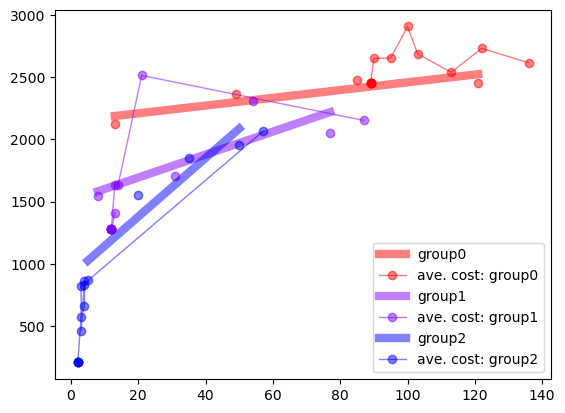

In [22]:
colors = {'group0':[1,0,0,0.5],'group1':[0.5,0,1,0.5],'group2':[0,0,1,0.5],'group3':[1,0.5,0.,0.5]};
WORLD1.ONDEMAND.plotCongestionModels(colors=colors,with_converge = True, save_file=save_outputs_folder+'/figs/demand_curves_wconvergence.pdf')

# SETUP SIMULATION

### GENERATE OUTPUTS

In [23]:
from multimodal_class import *
WORLD1.generateOutputs(); #randomize=['money','switches']);

### PRINT OUTPUTS

In [24]:
mode = 'ondemand'
dfs_to_show = [mode]
WORLD1.printOutputs(show_active=True,dfs_to_show = dfs_to_show,row_count = 100); 

drive statistics ... printing dataframe of length 0
walk statistics ... printing dataframe of length 98
gtfs statistics ... printing dataframe of length 36
ondemand statistics ... printing dataframe of length 103
              seg_id      mode  \
3      ondemand_seg3  ondemand   
12    ondemand_seg12  ondemand   
15    ondemand_seg15  ondemand   
20    ondemand_seg20  ondemand   
22    ondemand_seg22  ondemand   
25    ondemand_seg25  ondemand   
30    ondemand_seg30  ondemand   
37    ondemand_seg37  ondemand   
40    ondemand_seg40  ondemand   
41    ondemand_seg41  ondemand   
43    ondemand_seg43  ondemand   
46    ondemand_seg46  ondemand   
51    ondemand_seg51  ondemand   
53    ondemand_seg53  ondemand   
56    ondemand_seg56  ondemand   
58    ondemand_seg58  ondemand   
59    ondemand_seg59  ondemand   
61    ondemand_seg61  ondemand   
62    ondemand_seg62  ondemand   
63    ondemand_seg63  ondemand   
67    ondemand_seg67  ondemand   
72    ondemand_seg72  ondemand   
75   

### SAVE OUTPUTS

In [25]:
WORLD1.saveOutputs(save_outputs_folder,typ='pickle',overwrite=True)

overwriting...


### GENERATE DASHBOARD

In [26]:
from multimodal_class import *
WORLD1.generateLayers();
WORLD1.plotLAYERS(folder = dashboard_folder,overwrite = True,verbose=False)

starting to create plotting layers...
time to create layers: 10.310039043426514
starting layers...
PLOTTING LAYER 0 ...
PLOTTING LAYER 20 ...
PLOTTING LAYER 40 ...
PLOTTING LAYER 60 ...
PLOTTING LAYER 80 ...
PLOTTING LAYER 100 ...
PLOTTING LAYER 120 ...
PLOTTING LAYER 140 ...
PLOTTING LAYER 160 ...
PLOTTING LAYER 180 ...
PLOTTING LAYER 200 ...
PLOTTING LAYER 220 ...
finished.


### SHOW DASHBOARD

In [27]:
from multimodal_class import *
WORLD1.DASH = DASHBOARD(WORLD1.dash_folder);
WORLD1.DASH.makeGrid();
WORLD1.DASH.addOutputs(WORLD1.OUTPUTS,use_active=True,filter_for_zeros=True)
WORLD1.DASH.addImages(WORLD1.layers)

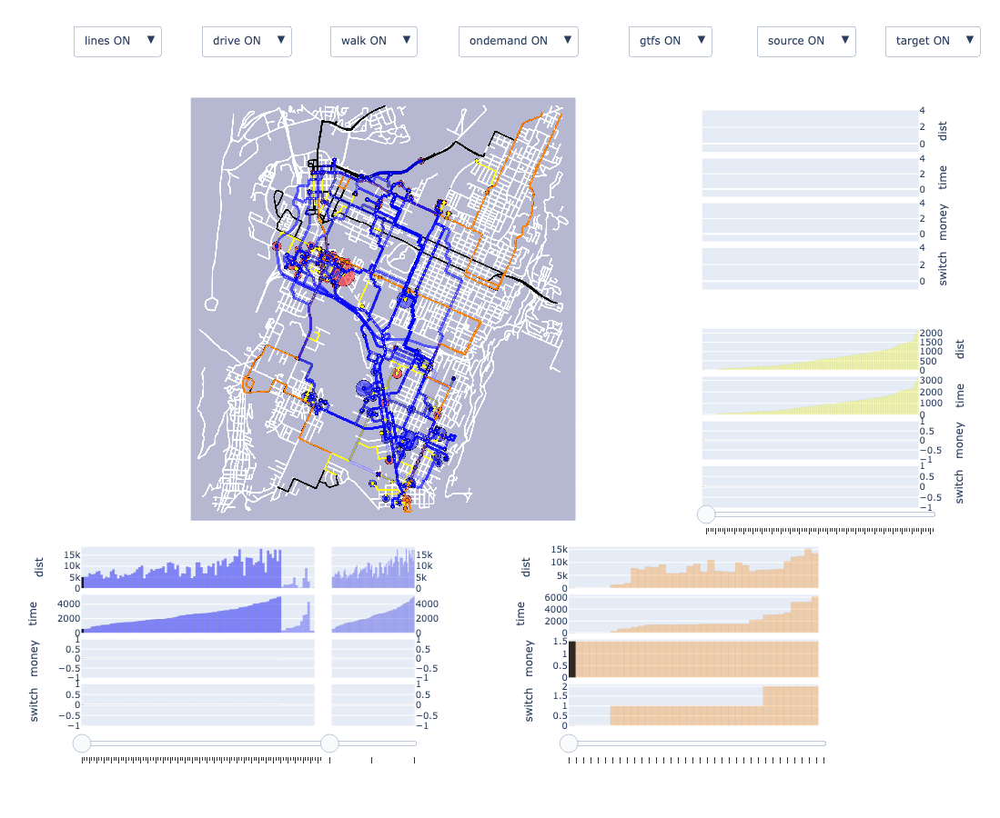

In [28]:
WORLD1.DASH.show()

### CREATE HTML DASHBOARD

In [29]:
import plotly.io as pio
pio.write_html(WORLD1.DASH.fig, file=dashboard_folder+'/dash.html', auto_open=True)

####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT 
####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT 
####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT 
####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT ####  END OF CURRENT 

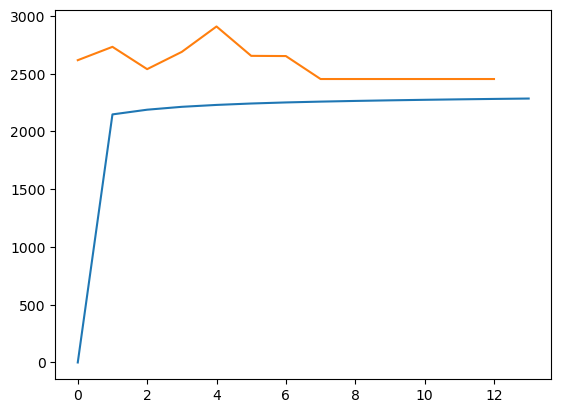

In [30]:
group = 'group0'
GROUP = WORLD1.ONDEMAND.groups[group];
# GROUP.actual_num_segs = [];
# GROUP.expected_cost = [];
# GROUP.actual_average_cost = [];
plt.plot(GROUP.expected_cost)
plt.plot(GROUP.actual_average_cost)

# actual_num_segs.append(num_segs)
# GROUP.expected_cost.append(new_ave_cost)
# GROUP.current_expected_cost = new_ave_cost
# GROUP.actual_average_cost.append(average_time)


In [31]:
# group='group1'
# GROUP = WORLD1.ONDEMAND.groups[group];
# GROUP.actual_num_segs = GROUP.actual_num_segs[6:]
